In [4]:
import pandas as pd 
import datetime
import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator
import numpy as np
import plotly.express as px
plt.style.use('ggplot')

In [5]:
df = pd.read_csv(
    'ChargePoint Data CY20Q4.csv', dtype={'Station Name': str}, 
    parse_dates=['Start Date'], infer_datetime_format=True, low_memory=False)

# Make a unique id for each row
df['Id'] = df.index
# Drop columns that are not needed
df.drop(
    ['User ID', 'County', 'City', 'Postal Code', 'Driver Postal Code',
    'State/Province', 'Fee', 'Currency', 'EVSE ID', 'Transaction Date (Pacific Time)',
    'GHG Savings (kg)', 'Gasoline Savings (gallons)', 'Org Name',
    'Address 1', 'System S/N', 'Plug In Event Id', 'Ended By',
    'End Time Zone', 'Start Time Zone', 'Country', 'Model Number'
    ], axis=1, inplace=True)

df.isna().sum()

Station Name                 0
MAC Address                  0
Start Date                   0
End Date                     0
Total Duration (hh:mm:ss)    0
Charging Time (hh:mm:ss)     0
Energy (kWh)                 0
Port Type                    9
Port Number                  0
Plug Type                    0
Latitude                     0
Longitude                    0
Id                           0
dtype: int64

In [6]:
# There's Excel formatting in the End Data column, so we need to convert from Excel serial to datetime
# https://stackoverflow.com/questions/6706231/fetching-datetime-from-float-in-python
def convert_to_datetime(serial):
    try:
        return pd.to_datetime(serial)
    except:
        seconds = (float(serial) - 25569) * 86400.0
        return datetime.datetime.utcfromtimestamp(seconds)

df['End Date'] = df['End Date'].apply(convert_to_datetime)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 259415 entries, 0 to 259414
Data columns (total 13 columns):
 #   Column                     Non-Null Count   Dtype         
---  ------                     --------------   -----         
 0   Station Name               259415 non-null  object        
 1   MAC Address                259415 non-null  object        
 2   Start Date                 259415 non-null  datetime64[ns]
 3   End Date                   259415 non-null  datetime64[ns]
 4   Total Duration (hh:mm:ss)  259415 non-null  object        
 5   Charging Time (hh:mm:ss)   259415 non-null  object        
 6   Energy (kWh)               259415 non-null  float64       
 7   Port Type                  259406 non-null  object        
 8   Port Number                259415 non-null  int64         
 9   Plug Type                  259415 non-null  object        
 10  Latitude                   259415 non-null  float64       
 11  Longitude                  259415 non-null  float64 

## Create clusters based on Station Names

In [7]:
print("Number of unique stations:", df['Station Name'].nunique())
df['Cluster'] = df['Station Name'].str.split(' ').str[4]
print(df['Cluster'].value_counts())

Number of unique stations: 47
BRYANT       47100
HIGH         39901
HAMILTON     38609
WEBSTER      37585
CAMBRIDGE    32879
MPL          28326
RINCONADA    18264
TED          16712
SHERMAN         39
Name: Cluster, dtype: int64


## Plot the stations on a map

In [8]:
# plot the geographical distribution of the charging stations
fig = px.scatter_mapbox(df, lat="Latitude", lon="Longitude", hover_name="Station Name")
fig.update_layout(
    height=600, 
    mapbox_style="open-street-map", 
    margin={"r":0,"t":0,"l":0,"b":0},
    mapbox_zoom=10, # zoom into the map
    mapbox_center_lat=df['Latitude'].mean(), mapbox_center_lon=df['Longitude'].mean() # center the map
    )
fig.show()

[]

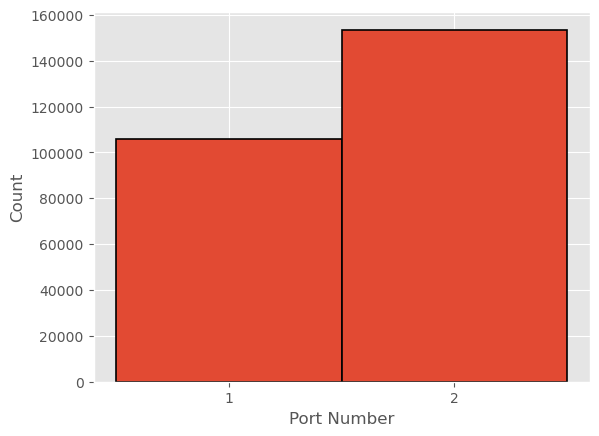

In [9]:
bins = np.arange(1, df['Port Number'].max() + 1.5) - 0.5
# then you plot away
fig, ax = plt.subplots()
_ = ax.hist(df['Port Number'], bins, edgecolor='k', linewidth=1.2)
ax.set_xticks(bins + 0.5)
ax.set_xlabel('Port Number')
ax.set_ylabel('Count')
plt.plot()

In [53]:
INTERVAL_LENGTH = 30 # minutes
df_combined = pd.DataFrame()
for cluster in df['Cluster'].unique():
    df[df.Cluster == cluster, 'Period'] = [pd.date_range(s, e, freq='T') for s, e in zip(df['Start Date'], df['End Date'])]
    res = df.explode('Period').groupby(pd.Grouper(key='Period', freq=f'{INTERVAL_LENGTH}T'))['Id'].nunique()
    # rename energy to sessions
    res.rename('Sessions', inplace=True)
    data = res.to_frame()
    data = data.reset_index()
    data.Period = pd.to_datetime(data.Period)
    data["Cluster"] = cluster
    df_combined = pd.concat([df_combined, data])

## 2nd attempt

In [47]:
df.head()

,Station Name,MAC Address,Start Date,End Date,Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Id,Cluster,Period
0,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-29 20:17:00,2011-07-29 23:20:00,3:03:32,1:54:03,6.249457,Level 2,2,J1772,37.444572,-122.160309,0,HAMILTON,"DatetimeIndex(['2011-07-29 20:17:00', '2011-07..."
1,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 00:00:00,2011-07-30 00:02:00,0:02:06,0:01:54,0.106588,Level 2,2,J1772,37.444572,-122.160309,1,HAMILTON,"DatetimeIndex(['2011-07-30 00:00:00', '2011-07..."
2,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 08:16:00,2011-07-30 12:34:00,4:17:32,4:17:28,14.951777,Level 2,2,J1772,37.444572,-122.160309,2,HAMILTON,"DatetimeIndex(['2011-07-30 08:16:00', '2011-07..."
3,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 14:51:00,2011-07-30 16:55:00,2:03:24,2:02:58,7.159643,Level 2,2,J1772,37.444572,-122.160309,3,HAMILTON,"DatetimeIndex(['2011-07-30 14:51:00', '2011-07..."
4,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2011-07-30 18:51:00,2011-07-30 20:03:00,1:11:24,0:43:54,1.957765,Level 2,2,J1772,37.444572,-122.160309,4,HAMILTON,"DatetimeIndex(['2011-07-30 18:51:00', '2011-07..."


Period
2011-07-29 20:15:00    1
2011-07-29 20:20:00    1
2011-07-29 20:25:00    1
2011-07-29 20:30:00    1
2011-07-29 20:35:00    1
2011-07-29 20:40:00    1
2011-07-29 20:45:00    1
2011-07-29 20:50:00    1
2011-07-29 20:55:00    1
2011-07-29 21:00:00    1
2011-07-29 21:05:00    1
2011-07-29 21:10:00    1
2011-07-29 21:15:00    1
2011-07-29 21:20:00    1
2011-07-29 21:25:00    1
2011-07-29 21:30:00    1
2011-07-29 21:35:00    1
2011-07-29 21:40:00    1
2011-07-29 21:45:00    1
2011-07-29 21:50:00    1
2011-07-29 21:55:00    1
2011-07-29 22:00:00    1
2011-07-29 22:05:00    1
2011-07-29 22:10:00    1
2011-07-29 22:15:00    1
2011-07-29 22:20:00    1
2011-07-29 22:25:00    1
2011-07-29 22:30:00    1
2011-07-29 22:35:00    1
2011-07-29 22:40:00    1
2011-07-29 22:45:00    1
2011-07-29 22:50:00    1
2011-07-29 22:55:00    1
2011-07-29 23:00:00    1
2011-07-29 23:05:00    1
2011-07-29 23:10:00    1
2011-07-29 23:15:00    1
2011-07-29 23:20:00    1
2011-07-29 23:25:00    0
2011-07-29 23:30:0

In [41]:
df_combined.head()

,Period,Sessions,Cluster
0,2011-07-29 20:00:00,1,HAMILTON
1,2011-07-29 21:00:00,1,HAMILTON
2,2011-07-29 22:00:00,1,HAMILTON
3,2011-07-29 23:00:00,1,HAMILTON
4,2011-07-30 00:00:00,1,HAMILTON


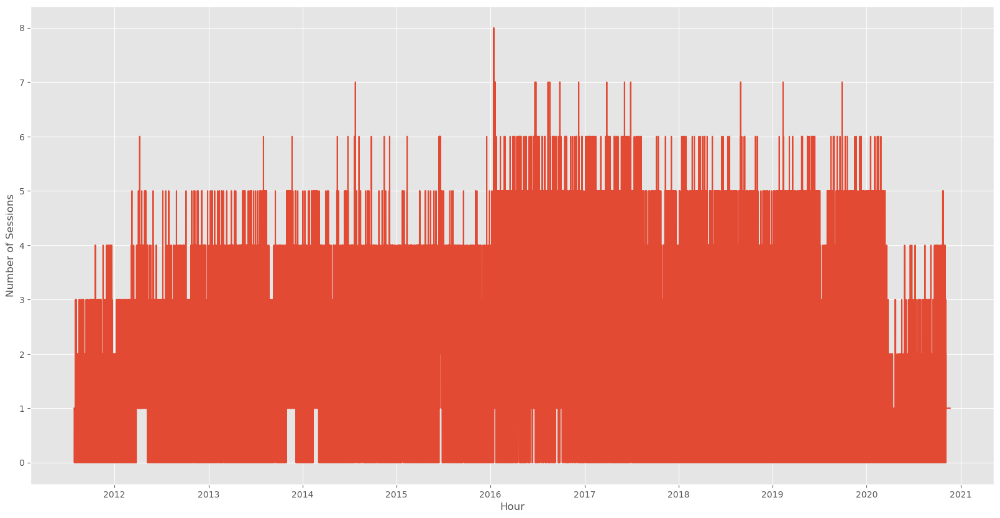

In [43]:
fig, ax = plt.subplots(figsize=(20, 10))
boi = df_combined[df_combined.Cluster == 'HAMILTON']
ax.plot(boi.Period, boi.Sessions)
# Make y-axis integral
ax.yaxis.set_major_locator(MaxNLocator(integer=True))
ax.set_xlabel('Hour')
ax.set_ylabel('Number of Sessions')
plt.show()

In [35]:
df_combined[df_combined.Cluster == 'HAMILTON'].iloc[-24*7:]

,Period,Sessions,Cluster
81464,2020-11-13 04:00:00,1,HAMILTON
81465,2020-11-13 05:00:00,1,HAMILTON
81466,2020-11-13 06:00:00,1,HAMILTON
81467,2020-11-13 07:00:00,1,HAMILTON
81468,2020-11-13 08:00:00,1,HAMILTON
...,...,...,...
81627,2020-11-19 23:00:00,1,HAMILTON
81628,2020-11-20 00:00:00,1,HAMILTON
81629,2020-11-20 01:00:00,1,HAMILTON
81630,2020-11-20 02:00:00,1,HAMILTON


In [39]:
df[df.Cluster == 'HAMILTON'].sort_values(by='Start Date', ascending=False).head(10)

,Station Name,MAC Address,Start Date,End Date,Total Duration (hh:mm:ss),Charging Time (hh:mm:ss),Energy (kWh),Port Type,Port Number,Plug Type,Latitude,Longitude,Id,Cluster
257337,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-04 04:54:00,2020-11-04 06:50:00,1:56:47,1:53:10,5.221,Level 2,2,J1772,37.444706,-122.160324,257337,HAMILTON
257335,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 18:03:00,2020-11-20 03:11:00,5:40:12,5:22:23,16.590,Level 2,2,J1772,37.444489,-122.160370,257335,HAMILTON
257332,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 17:29:00,2020-11-03 19:07:00,1:38:20,1:38:02,5.562,Level 2,1,J1772,37.444706,-122.160324,257332,HAMILTON
257330,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 16:45:00,2020-11-03 21:43:00,4:58:02,4:57:51,15.403,Level 2,2,J1772,37.444706,-122.160324,257330,HAMILTON
257322,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 13:59:00,2020-11-03 14:58:00,0:58:36,0:58:30,5.508,Level 2,2,J1772,37.444489,-122.160370,257322,HAMILTON
257297,PALO ALTO CA / HAMILTON #1,000D:6F00:015A:9D76,2020-11-03 08:48:00,2020-11-03 11:40:00,2:51:22,2:11:55,6.545,Level 2,2,J1772,37.444489,-122.160370,257297,HAMILTON
257294,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 07:42:00,2020-11-03 16:17:00,8:34:51,8:34:34,47.757,Level 2,1,J1772,37.444706,-122.160324,257294,HAMILTON
257290,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-03 05:00:00,2020-11-03 07:02:00,2:02:42,1:47:46,4.948,Level 2,1,J1772,37.444706,-122.160324,257290,HAMILTON
257286,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 16:14:00,2020-11-02 21:58:00,5:43:50,5:43:30,32.128,Level 2,1,J1772,37.444706,-122.160324,257286,HAMILTON
257262,PALO ALTO CA / HAMILTON #2,0024:B100:0002:965D,2020-11-02 04:42:00,2020-11-02 06:44:00,2:01:32,1:46:28,4.873,Level 2,1,J1772,37.444706,-122.160324,257262,HAMILTON
